----
# Introduction to Data Science and Systems


## Self-study: Arrays, numpy and vectorisaiton

### Chapter 3: Creating, indexing, slicing, joining and rotating¶

##### University of Glasgow - material prepared by John H. Williamson* (adapted to IDSS by BSJ).
 
 
$$\newcommand{\vec}[1]{{\bf #1}} 
\newcommand{\real}{\mathbb{R}}
\newcommand{\expect}[1]{\mathbb{E}[#1]}
\DeclareMathOperator*{\argmin}{arg\,min}
%\vec{x}
%\real
$$



---



In [1]:
import IPython.display
IPython.display.HTML("""
<script>
  function code_toggle() {
    if (code_shown){
      $('div.input').hide('500');
      $('#toggleButton').val('Show Code')
    } else {
      $('div.input').show('500');
      $('#toggleButton').val('Hide Code')
    }
    code_shown = !code_shown
  }

  $( document ).ready(function(){
    code_shown=false;
    $('div.input').hide()
  });
</script>
<form action="javascript:code_toggle()"><input type="submit" id="toggleButton" value="Show Code"></form>""")

In [70]:
import numpy as np
import matplotlib.pyplot as plt
from jhwutils.image_audio import play_sound, show_image, load_image_colour, load_image_gray, show_image_mpl,load_sound,play_sound
from jhwutils.matrices import show_boxed_tensor_latex, print_matrix
%matplotlib inline

---

## Creating `numpy` arrays

### Converting and copying: np.array
New arrays can be created in several ways:

* Converted from another sequence type, like a list: `np.array()` does this.
* Created blank and filled with some value.  This is often essential in creating temporary variables, for example to accumulate results into.
* Filled with random values.
* Loaded from disk.

`np.array()` takes a sequence and converts it into an array; this can be, for example, a list.
It works for multidimensional arrays as well, given nested sequences. 

## Mutability and copying
`np.array()` can take any sequence, including another ndarray. So it can be used to copy arrays:

This is important, because NumPy arrays are **mutable**, and if several variables refer to the **same** array, the effects might not be what you expect:

In [3]:
x = np.array([1,2,3])
z = x
x[0] = 0
print(x)
print(z) # huh?

[0 2 3]
[0 2 3]


We need to explicitly copy arrays if we want to work on a new array:

In [4]:
x = np.array([1,2,3])
y = np.array(x) # copy
z = x.copy() # same thing as using np.array(x)
x[0] = 0
print(x) # 0 2 3
print(y) # still 1 2 3
print(z)

[0 2 3]
[1 2 3]
[1 2 3]


### Ragged arrays (bad!)
What happens if we **don't** follow the rectangular array rule?

In [5]:
# This **looks** like it works, but it doesn't do what we want
bad_array = np.array([
                [1.0, 2.0, 3.0, 6.0, 7.0],
                [0.0, 0.5, 0.0],  # ragged!
                [5.0, 0.0, 10.0]
               ])
print(bad_array)

# uh oh, it's not an array of numbers
print((bad_array.dtype))

# it's a 3 element array of lists (not very useful)
print((bad_array.shape))

[list([1.0, 2.0, 3.0, 6.0, 7.0]) list([0.0, 0.5, 0.0])
 list([5.0, 0.0, 10.0])]
object
(3,)


In general, *never* create ragged arrays. Always make sure you are creating rectangular arrays!

# Blank arrays

As in the lab, we saw a number of methods all of which do essentially the same thing; allocate a new array with a given shape, and possibly fill it with a value.

* `np.zeros(shape)`, 
* `np.ones(shape)`, 
* `np.full(shape,value)`

These are just calling `np.empty(shape)` to create a new array and then filling it with a given value.

For example, `x = np.ones((5,8))` is exactly the same as:

    x = np.empty(5,8)
    x[:] = 1.0  # this sets all values to 1.0
    

### Blank like
Similarly, we can create blank arrays with the same shape and dtype as an existing array using the `_like` variants. `y = np.zeros_like(x)` is exactly the same as:

    y = np.empty(x.shape, dtype=x.dtype)
    y[:] = 0.0
    
### Random arrays
    

We can also generate random numbers to fill arrays. Many algorithms use arrays of
random numbers as their basic "fuel". 

* `np.random.randint(a,b,shape)` creates an array with uniform random *integers* between a and (excluding) b
* `np.random.uniform(a,b,shape)` creates an array with uniform random *floating point* numbers between a and b
* `np.random.normal(mean,std,shape)` creates an array with normally distributed random floating point numbers between with the given mean and standard deviation.


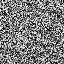

In [6]:
# a 64x64 block of random numbers
show_image(np.random.uniform(0,1,(64, 64)), width="10%")

# Ranges

## arange
We can create a vector of increasing values using `arange` (**a**rray **range**), which works like the built in Python function `range` does, but returns an 1D array (a vector) instead of a list.

`np.arange()` takes one to three parameters:
* `np.arange(end)`  -- returns a vector of numbers 0..end-1
* `np.arange(start, end)`  -- returns a vector of numbers start..end-1
*  `np.arange(start, end, step)` --returns a vector of numbers start..end-1, incrementing by step (which may be **negative** and/or **fractional**!)


### Linspace
`np.arange` is useful for generating evenly spaced values, but it is parameterised in a form that can be awkward. 

`np.linspace(start, stop, steps)` is a much easier to use alternative. `linspace` stands for "**lin**early **space**d", and it generates `steps` values between `start` and `stop` **inclusive**. 

In [7]:
np.linspace(0,10,11) # careful -- end is inclusive, so we need 11 steps if we want integer spacing

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10.])

In [8]:
# show a gradient, using linspace to generate an array, and then duplicate it onto 20 rows
show_image(np.tile(np.linspace(0,1,100), (20,1)))

### Loading and saving arrays
I/O with arrays is a critical part of any numerical computation system. There are a huge number of ways to store and recall arrays, including:
* simple text formats like CSV (comma separated values)
* binary formats for storing single or multiple arrays like mat and npz
* specialised scientific data formats like HDF5 (often used for huge datasets)
* domain-specific formats like images (png, jpg, etc.), sounds (wav, mp3, etc.), 3D geometry (obj, ...)

#### Text files
*  `np.loadtxt(fname)` and 
* `np.savetxt(arr, fname)` 

work on simple text files.

In [9]:
# this just turns off scientific notation, so the output looks sensible!
np.set_printoptions(suppress=True) 

# load and print, in a single array
sunspots = np.loadtxt("data/sunspots.csv", delimiter=',')
print(sunspots)

[[   1.         1749.           58.        ]
 [   2.         1749.08333333   62.6       ]
 [   3.         1749.16666667   70.        ]
 ...
 [2818.         1983.75         55.8       ]
 [2819.         1983.83333334   33.3       ]
 [2820.         1983.91666667   33.4       ]]


---------------

# Slicing and indexing arrays
Arrays can be indexed like lists or sequences (in Python, this uses square brackets []), but arrays can have **multidimensional** indices. These are indices which are really tuples of values.

This means we write the variable, with the index in square brackets, where the index might have comma separated values. Indices start at **zero**!

Indexing, and its counterpart slicing, are two of the most important array operations.

The general format follows the same principles as `arange()`, taking 0-3 parameters separated by a `:`

    start : stop : step
    
Where `start` is the index to start from, `stop` is the end, and `step` is the jump to make between each step. **Any of these parts can be omitted**.

* If there is no colon, this specifies a specific index, for example x[0] or x[18]
* If there is one colon, this is a range; for example x[2:5] or x[:4] or x[0:]
* If there are two colons, this is a range with a step, like x[0:10:2], or x[:10:2] or x[::-1]

* If `start` is missing, it defaults to 0
* If `end` is missing, it defaults to the last element
* If `step` is missing, it defaults to 1. You don't need to include the second colon if you are omitting step, though it's not an error to do so.



#### Negative indices
Negative indices mean *counting from the end*; so `x[-1]` is the last element, `x[-2]` is the second last, etc.

If we specify an axis as an index (no range), we get back a  **slice** of that array, with fewer dimensions. If `x` is 2D, then `x[0,:]` is the first row (a 1D vector), and `x[:,0]` is the first column (a 1D vector).


In [10]:
print(sunspots[:,1]) # second column (remember 0-indexing!)

[1749.         1749.08333333 1749.16666667 ... 1983.75       1983.83333334
 1983.91666667]


In [11]:
print(sunspots[0,:]) # first row (note the row=0, column=any)

[   1. 1749.   58.]


In [12]:
print(sunspots[0:10,1:]) # first ten rows, second column onwards (start specified, but not stop)

[[1749.           58.        ]
 [1749.08333333   62.6       ]
 [1749.16666667   70.        ]
 [1749.25         55.7       ]
 [1749.33333333   85.        ]
 [1749.41666667   83.5       ]
 [1749.5          94.8       ]
 [1749.58333333   66.3       ]
 [1749.66666667   75.9       ]
 [1749.75         75.5       ]]


In [13]:
# every tenth row, up to row 100, second column onwards
# note this uses the full start:stop:step slicing
print(sunspots[0:100:10,1:]) 

[[1749.           58.        ]
 [1749.83333333  158.6       ]
 [1750.66666667   91.2       ]
 [1751.5          66.3       ]
 [1752.33333333   59.7       ]
 [1753.16666667   45.7       ]
 [1754.            0.        ]
 [1754.83333333   13.2       ]
 [1755.66666667   17.8       ]
 [1756.5           3.6       ]]


In [14]:
# whole array, every sixtieth row. Note that start and stop are *both* omitted here
# and only step is given.
print(sunspots[::60,:]) 

[[   1.  1749.    58. ]
 [  61.  1754.     0. ]
 [ 121.  1759.    48.3]
 [ 181.  1764.    59.7]
 [ 241.  1769.    73.9]
 [ 301.  1774.    46.8]
 [ 361.  1779.   114.7]
 [ 421.  1784.    13. ]
 [ 481.  1789.   114. ]
 [ 541.  1794.    45. ]
 [ 601.  1799.     1.6]
 [ 661.  1804.    45.3]
 [ 721.  1809.     7.2]
 [ 781.  1814.    22.2]
 [ 841.  1819.    32.5]
 [ 901.  1824.    21.6]
 [ 961.  1829.    43. ]
 [1021.  1834.     4.9]
 [1081.  1839.   107.6]
 [1141.  1844.     9.4]
 [1201.  1849.   156.7]
 [1261.  1854.    15.4]
 [1321.  1859.    83.7]
 [1381.  1864.    57.7]
 [1441.  1869.    60.9]
 [1501.  1874.    60.8]
 [1561.  1879.     0.8]
 [1621.  1884.    91.5]
 [1681.  1889.     0.8]
 [1741.  1894.    83.2]
 [1801.  1899.    19.5]
 [1861.  1904.    31.6]
 [1921.  1909.    56.7]
 [1981.  1914.     2.8]
 [2041.  1919.    48.1]
 [2101.  1924.     0.5]
 [2161.  1929.    68.9]
 [2221.  1934.     3.4]
 [2281.  1939.    80.3]
 [2341.  1944.     3.7]
 [2401.  1949.   119.1]
 [2461.  1954.  

In [15]:
print(sunspots[0,1]) # first entry in second column
# note that there is no colon here; this indexes rather than slices

1749.0


### Slicing versus indexing

* **Slicing** does not change the rank of an array. It selects a rectangular subset with the same number of dimensions.
* **Indexing** reduces the rank of an array (usually). It selects a rectangular subset where one dimension is a singleton, and removes that dimension.

In [16]:
print(sunspots[0].shape) # indexes first row, does reduce rank

(3,)


In [17]:
print(sunspots[0:1].shape) # slices first row, does not reduce rank

(1, 3)


## Boolean tests
We can do any test (like equality, greater than, etc.) on arrays as well: the result is a **Boolean array**, with the same shape as the original array (despite how they appear, these are actually numeric arrays internally):

In [18]:
x2 = np.array([[1,2,3], [4,5,6], [7,8,9]])


In [19]:
from utils.matrices import print_matrix
print_matrix("x_2",x2)
print_matrix("x_2>5",x2>5)


<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [20]:
y2 = np.array([[1,-1,1], [-1,1,-1], [1,-1,1]])
print_matrix("y_2", y2)
print_matrix("x_2>y_2", x2>y2)

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [21]:
# we can freely combine comparisons and arithmetic
print_matrix("x_2 = y_2+2", x2 == y2+2)

<IPython.core.display.Latex object>

## Rearranging arrays

Arrays can be transformed and reshaped; this means that they keep the same elements, but the arrangements of the elements are changed. For example, the sequence 
    
    [1,2,3,4,5,6]
    
could be rearranged into

    [6,5,4,3,2,1]

which has the same elements but now ordered backwards. 

These operations are often very useful to rearrange arrays so that broadcasting operations can be carried out effectively.


In [22]:
x = np.arange(6)+1
print_matrix("x", x)

<IPython.core.display.Latex object>

In [23]:
print_matrix("x_{r}", x[::-1]) # note slicing used to reverse

<IPython.core.display.Latex object>

## Transposition
A particularly useful transformation of an array is the **transpose** which exchanges rows and columns (this isn't the same as rotating 90 degrees!). There is special syntax for this because it is so often used:

We write `x.T` to get the transpose of `x`.

In [24]:
# square example
x = np.array([[1,2,3],[0,0,0],[4,5,6]])       
print_matrix("x", x)


<IPython.core.display.Latex object>

In [25]:
print_matrix("x^T", x.T)

<IPython.core.display.Latex object>

In [26]:
# non square example
y = np.array([[1,2], [3,4], [5,6]])
print_matrix("y", y)


<IPython.core.display.Latex object>

In [27]:
print_matrix("y^T", y.T)

<IPython.core.display.Latex object>

Transposition has *no effect* on a 1D array, and it reverses the order of all dimensions in >2D arrays.

In [28]:
tensor = np.zeros((10,5,60,2))  # 10 x 5 x 60 x 2 array

print("Original shape\t\t", tensor.shape)
print("Transposed shape\t", tensor.T.shape) # dimensions in reverse order

Original shape		 (10, 5, 60, 2)
Transposed shape	 (2, 60, 5, 10)


Note that transposing is a very fast operation -- it does not (normally) copy the array data, but just changes how it is accessed, and thus has virtually no time penalty, and completes in O(1) time. We will discuss how this is possible in the next lecture.

In [29]:
## show that transpose is fast, and does not depend on array sizze
x300 = np.zeros((300,300))
x3 = np.zeros((3,3))

In [30]:
%%timeit
x3.T

159 ns ± 6.38 ns per loop (mean ± std. dev. of 7 runs, 10000000 loops each)


In [31]:
%%timeit
x300.T

164 ns ± 6.91 ns per loop (mean ± std. dev. of 7 runs, 10000000 loops each)


### Flip, rotate
As well as transposition, arrays can also be flipped and rotated in a single operation:
    

In [32]:
print_matrix("x", x)

# left-right flip
print_matrix("\\text{fliplr}(x)", np.fliplr(x))
# up-down flip
print_matrix("\\text{flipud}(x)", np.flipud(x))
# rotate 90 (same as transpose + flipud)
print_matrix("\\text{rot90}(x)", np.rot90(x))

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

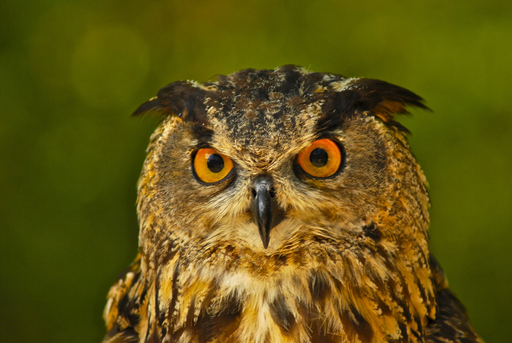

In [33]:
owl = load_image_colour("imgs/owl.png")
show_image(owl, width="50%")

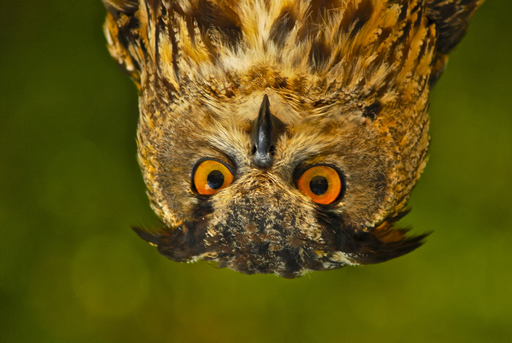

In [34]:
# flip up-down
show_image(np.flipud(owl), width="50%")

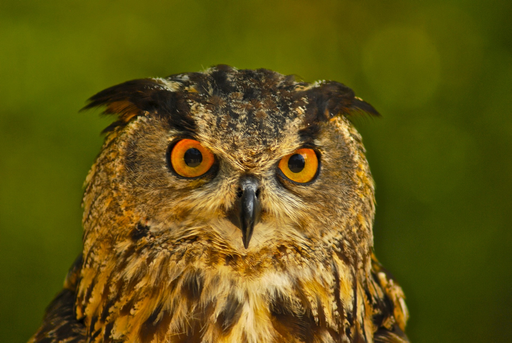

In [35]:
# flip left-right
show_image(np.fliplr(owl), width="50%")

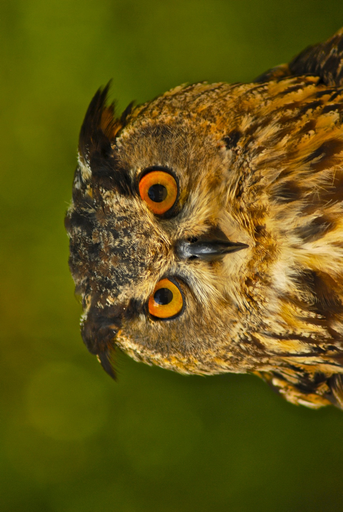

In [36]:
# rotate 90
show_image(np.rot90(owl), width="50%")

#### Symmetric owls

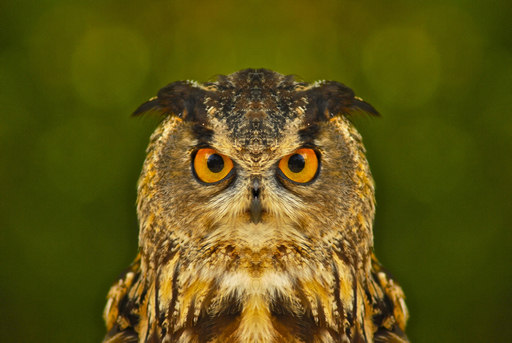

In [37]:
# split the owl into a left and right half
h,w,d = owl.shape

left = owl[:, :w//2, :]  # //2 just means integer division by 2 (i.e. no floating point part)
right = owl[:, w//2:, :]
## we'll see concatenate in a moment
show_image(np.concatenate([left, np.fliplr(left)], axis=1), width="50%")

# Cut+tape operations
## Joining and stacking
We can also join arrays together. But unlike simple structures like lists, we have to explicitly state on which **dimension** we are going to join. And we must adhere to the rule that the output array has rectangular shape; we can't end up with a "ragged" array. (arrays are *always* rectangular)

<img src="imgs/join.png" width="300px">

### concatenate and stack
Because arrays can be joined together along different axes, there are two distinct kinds of joining:
* We can use `concatenate` to join along an *existing* dimension;
* or `stack` to stack up arrays along a *new dimension.*

In [38]:
x = np.array([1,2,3,4])
y = np.array([5,6,7,8])
print_matrix("x", x)
print_matrix("y", y)

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [39]:
print_matrix("\\text{stack}(x, y)", np.stack([x,y]))

<IPython.core.display.Latex object>

In [40]:
print_matrix("\\text{concatenate}(x,y)", np.concatenate([x,y]))

<IPython.core.display.Latex object>

If we `concatenate` when we have multiple dimensions, we can specify explicitly
which axis to join on:

In [41]:
# when we have multiple dimensions, we can specify explicitly
# which axis to join on
x = np.zeros((3,3))
y = np.ones((3,3))
print_matrix("x", x)
print_matrix("y", x)

print_matrix("\\text{concatenate}_0(x,y)", np.concatenate([x,y], axis=0))
print_matrix("\\text{concatenate}_1(x,y)", np.concatenate([x,y], axis=1))
      


<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

As a shorthand, there are three defined stacking operations for specific axes when working with 2D matrices:
    * `np.hstack()` stacks horizontally
    * `np.vstack()` stacks vertically
    * `np.dstack()` stacks "depthwise" (i.e. one matrix on top of another)
All of these operate on 2D matrices

In [42]:
print((np.hstack([x,y])))  # same as np.concatenate([x,y], axis=0)

[[0. 0. 0. 1. 1. 1.]
 [0. 0. 0. 1. 1. 1.]
 [0. 0. 0. 1. 1. 1.]]


In [43]:
print((np.vstack([x,y])))  # same as np.concatenate([x,y], axis=1)

[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [1. 1. 1.]
 [1. 1. 1.]
 [1. 1. 1.]]


In [44]:
print((np.dstack([x,y])))  # same as np.stack([x,y])

[[[0. 1.]
  [0. 1.]
  [0. 1.]]

 [[0. 1.]
  [0. 1.]
  [0. 1.]]

 [[0. 1.]
  [0. 1.]
  [0. 1.]]]


## Piecing together images


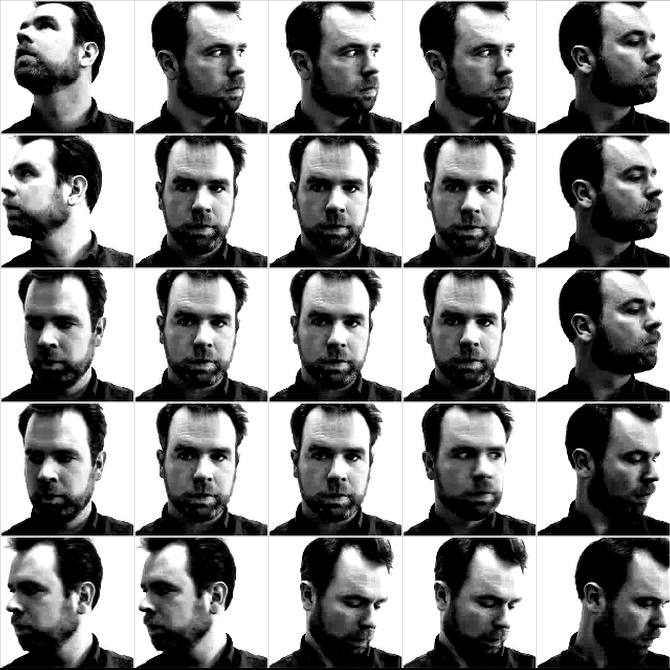

In [45]:
faces = load_image_gray("imgs/faces_5.png") # my face image from the intro lecture
show_image(faces, width="300px")

In [46]:
# don't worry about the reshape -- we'll discuss this next week
face_array = faces.reshape(5,134,5,134).swapaxes(1,2)

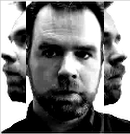

In [47]:
# I'll use this for my next album cover
slices =[]
for i in range(5):
    slices.append(face_array[1,i,:,i*26:(i+1)*26])
    
show_image(np.concatenate(slices, axis=1), width="300px")

## Tiling
We often need to be able to **repeat** arrays. This is called **tiling** and `np.tile(a, tiles)` will repeat `a` in the shape given by `tiles`, joining the result together into a single array.

In [48]:
eye = np.array([[1.,0.], [0.,-1.]])
print_matrix("e", eye)

<IPython.core.display.Latex object>

In [49]:
print("Repeated 4 times, columns")
print_matrix("e_{1,4}", np.tile(eye, (1,4)))


Repeated 4 times, columns


<IPython.core.display.Latex object>

In [50]:
print("Repeated 4 times, rows")
print_matrix("e_{4,1}", np.tile(eye, (4,1)))

Repeated 4 times, rows


<IPython.core.display.Latex object>

In [51]:
print("Repeated 2x2x2x2 times")

show_boxed_tensor_latex(np.tile(eye, (2,2,2,2)))


Repeated 2x2x2x2 times


<IPython.core.display.Latex object>

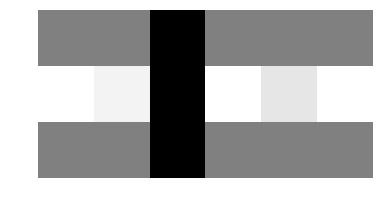

In [52]:
fret = np.array([[0.5, 0.5,0,0.5, 0.5,0.5], 
                 [1,0.95, 0, 1,0.9,1],
                 [0.5, 0.5, 0, 0.5, 0.5,0.5]])
show_image_mpl(fret)

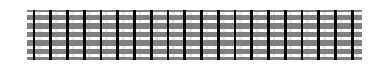

In [53]:
show_image_mpl(np.tile(fret, (6, 20)))
# <-- insert rest of guitar here

## Stretching sounds
We can use tiling to time stretch sounds:

In [54]:
# choose an even sized segment

guitar = load_sound("sounds/guitar.wav")
play_sound(guitar)

C:\python\Anaconda3_37_201812\lib\site-packages\scipy\io\wavfile.py:273: WavFileWarning: Chunk (non-data) not understood, skipping it.
  WavFileWarning)


In [55]:
snd = guitar[:48000*4]
# split into 4800 segment wide blocks
snd_s  = snd.reshape(-1,1200)
# tile each block 4 times, then read out the whole thing
# in one long thread
play_sound(np.tile(snd_s, (1,3)).ravel())

In [56]:
# we can actually fix the clicking easily
import scipy.signal
w = 1200
slow = 3
snd_s  = snd.reshape(-1,w)
snd2 = np.concatenate([np.zeros(w//2,), snd, np.zeros(w//2,)])
snd_s2  = snd2.reshape(-1,w)
n = scipy.signal.hann(w) # some magic
a = np.tile(snd_s*n, (1,slow)).ravel()
b = np.tile(snd_s2*n, (1,slow)).ravel()
play_sound((a+b[w//2:-(slow*w-w//2)]))

# Selection and masking
Comparisons between arrays result in Boolean arrays, as we have seen:

In [57]:
x = np.array([1,2,3,4])
y = np.array([2,2,2,2])
print_matrix("x",x)
print_matrix("y",y)
print_matrix("x>y", (x>y))

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

These Boolean arrays have many useful applications in **selecting** specific data, or alternatively **masking** specific data. Selection and masking are basic operations.

## where, nonzero
We can use a Boolean array to select elements of an array with `np.where(bool, a,b)` which selects `a` where `bool` is True  and `b` where `bool` is False. `bool`, `a` and `b` must be the same shape, or be broadcastable to the right shape.

In [58]:
print(np.where(x>y, 1, 0))

[0 0 1 1]


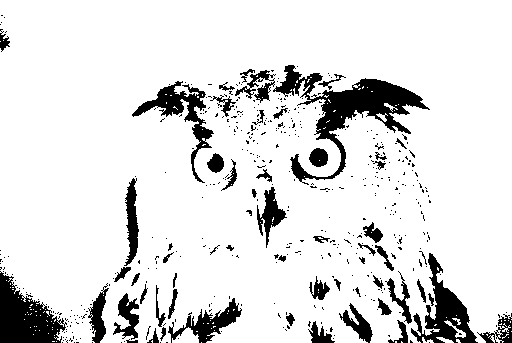

In [59]:
owl_gray = load_image_gray("imgs/owl.png")

# force to either black (0) or to white (1), by thresholding at 0.2
show_image(np.where(owl_gray<0.2, 0, 1), width="50%")

#### nonzero
We can convert a boolean array to an array of **indices** with `nonzero`

In [60]:
x = np.array([10,7,2,9,0,5,2,1])
print((np.nonzero(x>3)))

(array([0, 1, 3, 5], dtype=int64),)


In [61]:
## find *indices* where wheat price was > 50
wheat = np.loadtxt("data/Wheat.csv", delimiter=',')
expensive_rows = np.nonzero(wheat[:,2]>50)

## Fancy indexing
This brings us to the next operation -- an extension of indexing, which allows us to index arrays with arrays. It is a very powerful operator, because we can select *irregular* parts of an array and perform operations on them.

### Index arrays
For example, an array of **integer** indices can be used as an index directly:

In [62]:
x = np.array([10,20,30,40])
y = np.array([0,1,1,2,2,1])
print_matrix("x", x)
print_matrix("y", y)
print_matrix("x[y]", x[y])


<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [63]:
x2d = np.array([[10,20,30], [40, 50, 60], [70,80, 90]])
y2d = np.array([0,1,1])
## indexes as row slices
print((x2d[y2d]))

[[10 20 30]
 [40 50 60]
 [40 50 60]]


Dimensions are always still separated by commas:

In [64]:
z2d = np.array([0,0,2])
## indexes as row slices
## TRICKY: we index first by y2d (to get the array above), then by z2d to select the columns
print((x2d[y2d, z2d]))

[10 40 60]


In [65]:
## find indices where wheat price was > 50
expensive_indices = np.nonzero(wheat[:,2]>50)

# print the matching years
print((wheat[:,1][expensive_indices]))

[1595. 1645. 1795. 1800. 1805. 1810.]


### Boolean indexing
As well as using indices, we can directly index arrays with boolean arrays (as long as, again, they match the broadcasting rules).

For example, if we have an array 

    x = [1,2,3]
    
and an array
   
    bool = [True, False, True]
   
then `x[bool]` is the array:

    [1,3]
    
Note that this is pulling out *irregular* parts of the array (although the result is always guaranteed to be a rectangular array).    


In [66]:
x = np.array([1,2,3,4,5,6,7,8])
y = np.array([1,0,1,1,0,0,1,1])
print_matrix("x", x)
print_matrix("y", y)
print_matrix("x[y==0]", x[y==0])

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [67]:
# boolean arrays in broadcasting
x2d = np.array([[10,20,30],
                [40, 50, 60], 
                [70,80, 90]])

y = np.array([10,20,100])
first_column_bigger = x2d[:,0]<=y

print_matrix("x", x2d)
print_matrix("y", y)

print_matrix("x[x[:,0]\leq y]", x2d[first_column_bigger])
# select the rows where the first column of x is <= correspond element of y

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [68]:
# the wheat example, selecting years when the cost of wheat was > 50 shillings / quarter bushel
print((wheat[:,1][wheat[:,2]>50])) # note the double indexing

[1595. 1645. 1795. 1800. 1805. 1810.]


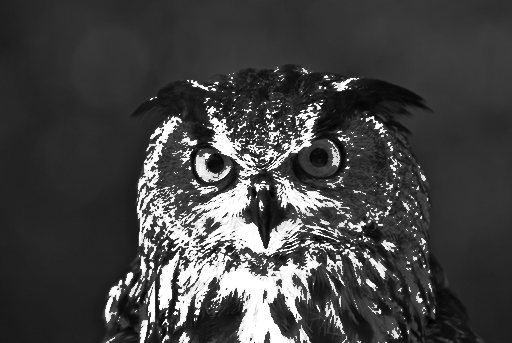

In [69]:
owl_masked = np.array(owl_gray) # copy the owl
# we can use fancy indexing in assignments, exactly as we would in any other operation
owl_masked[owl_masked<0.5] *= 0.6 # make the dark bits darker
owl_masked[owl_masked>0.5] *= 1.6 # and the light bits lighter

show_image(owl_masked, width="50%")

# Tensor operations
1D and 2D matrices are reasonably straightforward to work with. But many interesting data science problems like the EEG example involve arrays with higher rank; this is very common in deep learning, for example.

Being able to think about vectorised operations and then mold tensors to the right configurations to do what you want efficiently is a specialised and valuable skill.


## Reshape

As well as "rigid" transformations like `np.fliplr()` and `np.transpose()`, we can also reshape arrays to completely different shapes. The requirement is that the *elements* don't change; **thus the total number of elements cannot change during a reshaping operation.**


Regardless of how many dimensions an array has, it is still inherently a sequence of values; *the shape just changes how it is indexed.* In other words, it just writes a new set of strides. `ravel()` that we saw earlier, will show the "flat" representation:

In [110]:
x = np.array([1,2,3,4,5,6,7,8,9,10,11,12])
show_boxed_tensor_latex(x)
print(x.ravel()) # unsurprising

<IPython.core.display.Latex object>

[ 1  2  3  4  5  6  7  8  9 10 11 12]


In [111]:
y = np.array([[1,2,3], [4,5,6], [7,8,9]])
show_boxed_tensor_latex(y)
print(y.ravel()) # note: order is columns, then rows; always working from the last dimension back to the first

<IPython.core.display.Latex object>

[1 2 3 4 5 6 7 8 9]


### Reshaping rules
* The total number of elements will remain unchanged.
* The order of elements will remain unchanged; only the positions at which the array "wraps" into the next dimension.
* The last dimension changes fastest, the second last second fastest, etc.
#### The pouring rule
You can imagine a reshaping operation "pouring" the elements into a new mold. The ordering of the elements is retained, but will fill up the new shape.

<img src="imgs/reshape.png">


In [112]:
x = np.arange(12)  # 12 elt vector
x3x4 = x.reshape((3,4))
show_boxed_tensor_latex(x)
show_boxed_tensor_latex(x3x4)


<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [113]:
print(x3x4.reshape((6,2))) # fill columns, then rows
show_boxed_tensor_latex(x3x4.reshape((6,2)))

[[ 0  1]
 [ 2  3]
 [ 4  5]
 [ 6  7]
 [ 8  9]
 [10 11]]


<IPython.core.display.Latex object>

In [114]:
show_boxed_tensor_latex(x3x4.reshape((4,3)))

<IPython.core.display.Latex object>

In [ ]:
show_boxed_tensor_latex(x3x4.reshape((2,3,2))) # last dimension, then columns, then rows

In [ ]:
show_boxed_tensor_latex(x3x4.reshape((4,3,1))) # Can have 1 in any dimension

In [ ]:
show_boxed_tensor_latex(x3x4.reshape((1,3,4))) # A different shape

### Advanced reshaping: squeezing and adding dimensions
Imagine we want to multiply two vectors together (we'll see how this works in detail later). There are two possible orientations for a vector: a **row vector** and a **column vector**. Multiplying a row vector by a column vector results in a matrix (the *outer product*):


In [76]:
x = np.array([1,2,3])
y = np.array([-1,9,1])
print(np.dot(x,y)) # scalar product, row by row

20


In [77]:
print(np.dot(x,y.T)) # OK, so matrix product -- right?

20


In [78]:
print(y)
print(y.T) # huh? this does nothing?

[-1  9  1]
[-1  9  1]


Transposing a 1D vector has no effect -- it has only one dimensions and reversing the shape does nothing. So how can we get the effect of a column vector?

In fact, a 1D vector is *neither* a row vector or a column vector. It is just a 1D vector. The operations we might expect are operations on 2D matrices with a **singleton dimension**.

This requires **promoting** the vector to a matrix, by adding a new **singleton dimension**. In less fancy terms, it which just means adding a new dimension with a shape of 1:

In [79]:
y_col = np.reshape(y, (3,1))  # 3 rows x 1 column
x_col = np.reshape(y, (3,1))
print_matrix("x\cdot y^T", np.dot(x_col,y_col.T))

<IPython.core.display.Latex object>

### Adding dimensions

Because adding singleton dimensions is so common, there is special syntax for it. You can index an array with an additional dimension to **promote** it to a higher rank, if the
index is given as `None` or `np.newaxis` (they have the same effect). This inserts a new singleton dimension into the strides.

In [81]:
x = np.array([1,2,3]) # back to 1D

In [82]:
print(x[:].shape)  # just x
show_boxed_tensor_latex(x)

(3,)


<IPython.core.display.Latex object>

In [83]:
print(x[:].shape)  # just x
show_boxed_tensor_latex(x)

(3,)


<IPython.core.display.Latex object>

In [ ]:
print(x[:, np.newaxis].shape)  # add a new dimension (identical to the above)
show_boxed_tensor_latex(x[:, np.newaxis])

In [ ]:
print(x[None, None, :, None].shape)  # add lots of new dimensions
show_boxed_tensor_latex(x[None, None, :, None])

What if we want to remove dimensions? We can simply index to do this:
    

In [ ]:
x_4d = x[None, None, :, None]
show_boxed_tensor_latex(x_4d)
show_boxed_tensor_latex(x_4d[0,0,:,0])

### Squeezing
Singleton dimensions can get in the way of doing computations easily; often the result of a complex calculation is a multidimensional array with a bunch of singleton dimensions.

**squeezing** just removes *all* singleton dimensions in one go and is performed by `np.squeeze()`


show_boxed_tensor_latex(x_4d)
show_boxed_tensor_latex(np.squeeze(x_4d))  # back to 3 element vector

In [86]:
# 3x4 array
mat3x4 = np.arange(12).reshape((3,4))
show_boxed_tensor_latex(mat3x4)


<IPython.core.display.Latex object>

In [87]:
# insert some new dimensions (note that we can insert dimensions in between existing ones!)
mat3x4_5d = mat3x4[:,None,None,:,None]

print(mat3x4_5d.shape)
show_boxed_tensor_latex(mat3x4_5d)

(3, 1, 1, 4, 1)


<IPython.core.display.Latex object>

In [88]:

show_boxed_tensor_latex(np.squeeze(mat3x4_5d))

<IPython.core.display.Latex object>

### Elided axes
With large tensors it can be annoying to specify all the intermediate dimensions in an indexing operation, with lots of code that looks like:
    
    img_tensor[0,:,:,:,4]
    
Repeated : can be *elided* in an indexing expression using an *ellipsis* (three dots)

    img_tensor[0, ..., 4]
    
the dots replace as many : as required to make the shape of the index match the shape of the array.
    

In [93]:
mat3x4_5d[0,:,:,:,0]

array([[[0, 1, 2, 3]]])

In [94]:
mat3x4_5d[0,...,0]

array([[[0, 1, 2, 3]]])

In [95]:
mat3x4_5d[0,:,:,3,0]

array([[3]])

In [96]:
mat3x4_5d[0,...,3,0] # ... fills as many dimensions as required

array([[3]])

## Swapping and rearranging axes
We can rearrange the axes of our arrays as we wish, using `np.swapaxes(a, axis1, axis2)` to swap any pair of axes. For example, if we have a colour video, which is of shape `(frames, width,  height,  3)` and we want to apply an operation on each *column*, we can temporarily swap it to the end, broadcast, then swap it back. This is the generalisation of the transpose trick we saw earlier:

    (x.T + y).T   # adds y to every column of x


C:\python\Anaconda3_37_201812\lib\site-packages\IPython\kernel\__init__.py:13: ShimWarning: The `IPython.kernel` package has been deprecated since IPython 4.0.You should import from ipykernel or jupyter_client instead.
  "You should import from ipykernel or jupyter_client instead.", ShimWarning)


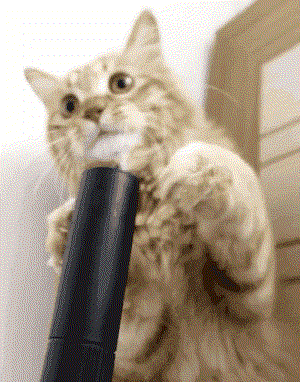

(51, 382, 300, 3)


In [97]:
import jhwutils.image_audio as ia
cat = ia.load_image_colour("imgs/catgif.gif")
ia.show_gif(cat, width="300px") 
print(cat.shape)

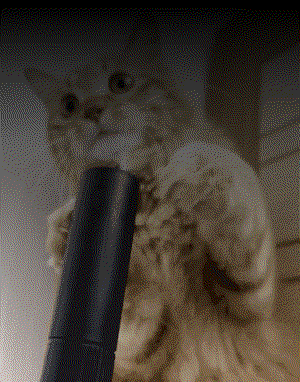

In [99]:
# swap the columns to the end; multiply by a gradient, broadcasting; swap back
gradient_cat = (np.swapaxes(cat, 1, 3) * np.linspace(0,1,cat.shape[1])).swapaxes(3,1)
ia.show_gif(gradient_cat, width="300px") 

Axis rearrangement is (usually) a simple change of the array strides and shape; the array itself is not changed, and so the operations completes in $O(1)$ time.



In [100]:
print(cat.strides)

(2750400, 7200, 24, 8)


In [101]:
# note that all we did was permute the strides in the array
# this is super fast :)
print(cat.swapaxes(2,3).strides)

(2750400, 7200, 8, 24)


### The swap, reshape, swap dance
Reshape always follows the pouring rule (last dimension pours first). Sometimes that isn't what we want to do. The solution is to:
* rearrange the axes
* reshape the array
* (optionally) rearrange the axes again

Imagine we want to get the cat gif as a film strip, splitting the colour channels into three rows, as if we had three strips of celluloid. This will be a reshape to size `(H*3, W*Frames)`.


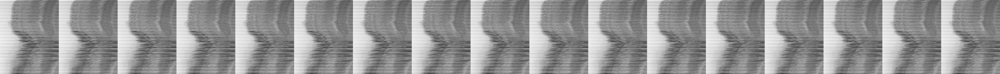

In [108]:
cat_strip = cat.reshape(cat.shape[1]*cat.shape[3], 
                        cat.shape[2]*cat.shape[0])
ia.show_image(cat_strip) # this not be good

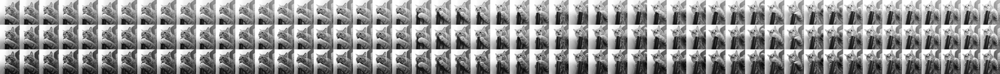

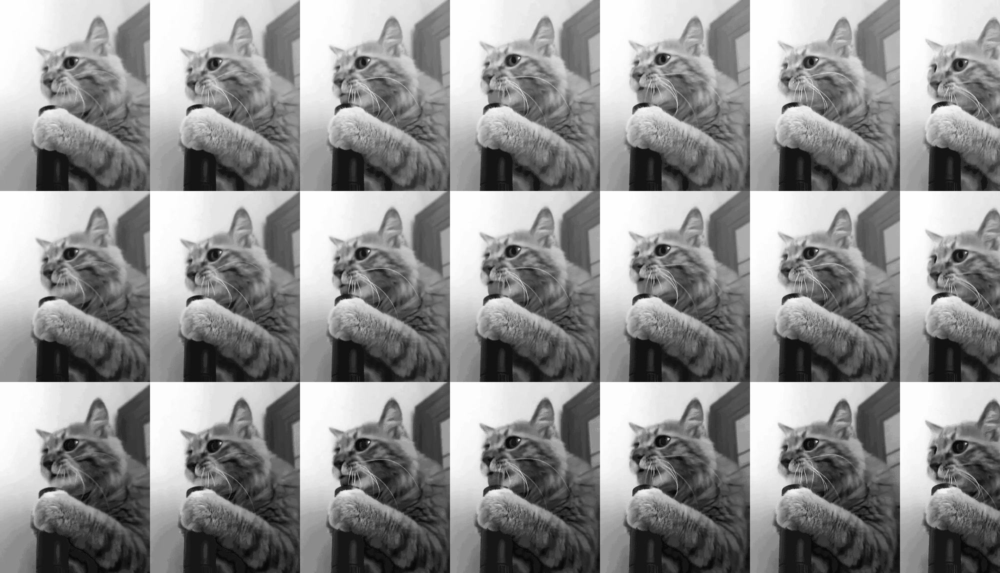

In [109]:
cat_strip = cat.swapaxes(3,0).swapaxes(2,3).reshape(
    cat.shape[1]*cat.shape[3], cat.shape[2]*cat.shape[0])
ia.show_image(cat_strip) # this is correct
ia.show_image(cat_strip[:,:2000])  # zoomed in version

### Einstein summation notation
<img src="imgs/einstein_1921.jpg" width="500px">

*[Image credit: public domain, from [Wikimedia Commons](https://upload.wikimedia.org/wikipedia/commons/3/3e/Einstein_1921_by_F_Schmutzer_-_restoration.jpg)]*

A very powerful generalisation of these operations is **Einstein summation notation**. This, in its simplest form, is a very easy way to reorder higher-rank tensors. As you can see from the example above, swapping axes gets confusing very fast. Einstein summation notation allows a specification of one letter names for dimensions (usually from `ijklmn...`), and then to write the dimension rearrangement *as a string*.

The notation writes the original order, followed by an `->` arrow, then a new order, like this:

    ijk -> jik

For example, 2D matrix transpose can be written like this:

In [103]:
x = np.array([[1,2,3], [4,5,6], [7,8,9]])
show_boxed_tensor_latex(x)
print()
show_boxed_tensor_latex(x.T)
print()

<IPython.core.display.Latex object>

<IPython.core.display.Latex object>

In [104]:
# switch first and second dimensions
print("Transposed via einsum\n")
show_boxed_tensor_latex(np.einsum('ij -> ji', x))
      

Transposed via einsum



<IPython.core.display.Latex object>

In [105]:
# einsum is really useful for higher order arrays
y = np.zeros((5,4,10,10))
y_rearranged = np.einsum('ijkl -> jlik', y)
print("Y shape", y.shape)
print("Y strides", y.strides)
print()
print("Y rearranged", y_rearranged.shape)
print("Y rearranged strides", y_rearranged.strides)

Y shape (5, 4, 10, 10)
Y strides (3200, 800, 80, 8)

Y rearranged (4, 10, 5, 10)
Y rearranged strides (800, 8, 3200, 80)


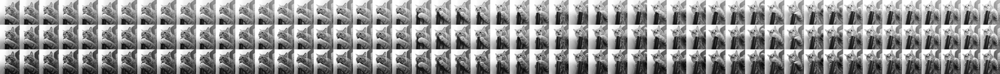

In [106]:
# slightly easier to understand
# we switch from 
# (f)rames, (r)ows, (c)olumns, (C)olours to
# (C)olours, (r)ows, (f)rames, (c)columns
cat_strip = np.einsum('frcC->Crfc', cat).reshape(
    cat.shape[1]*cat.shape[3], cat.shape[2]*cat.shape[0])
ia.show_image(cat_strip) 

### Extreme einsumming
`einsum` can also compute summations, products and diagonalisations in one single command, but this is beyond what we will cover in DF(H).

The power of `einsum` leverages the flexibility of the `ndarray` strided array structure. It makes a huge range of operations possible in a very compact form.

#### Optional reading
Read **A guide to Einstein sums** http://ajcr.net/Basic-guide-to-einsum/  if you want more details on using `np.einsum`.